In [3]:
import numpy as np
import json
import os, sys
try:
    import ConfigParser
except:
    import configparser
sys.path.append('../slidingwindow/')


In [2]:
wbc_labels = json.load(open('../../../data/datasetQuinn/annotation2/datasetQuinn_extra_labels.json', 'rb'))

In [62]:
for i in range(len(wbc_labels)):
    filename = str(wbc_labels[i]['filename'].split('/')[-1][:-4])
    boxes = make_data.get_bounding_boxes_for_single_image(os.path.join('..','..','data', 'datasetQuinn', 'annotation', filename +'.xml'))
    if boxes:
        for xmin, xmax, ymin, ymax in boxes: 
            w, h = float(xmax - xmin), float(ymax - ymin)
            x, y = float(xmin + 25.0), float(ymin + 25.0)
            wbc_labels[i]['annotations'].append({u'class': u'Falciparum',
                                                 u'height': 50.0,
                                                 u'id': u'Nat',
                                                 u'type': u'rect',
                                                 u'width': 50.0,
                                                 u'x': x,
                                                 u'y': y})

In [63]:
wbc_height, wbc_width = [], []
for item in wbc_labels:
    [d for d in item['annotations'] if d.get('class') in ['DEBRIS', 'Debris']]
    for anno in item['annotations']:
        if str(anno['class'])  == 'WBC':
#             maxval = np.maximum(anno['height'], anno['width'])
#             wbc_height.append(maxval)
#             wbc_width.append(maxval)
#             wbc_height.append(anno['height'])
#             wbc_width.append(anno['width'])
            anno['x'] += 35.0
            anno['y'] += 35.0
            anno['height'] = 100.0
            anno['width'] = 100.0

In [53]:
len(wbc_height)

0

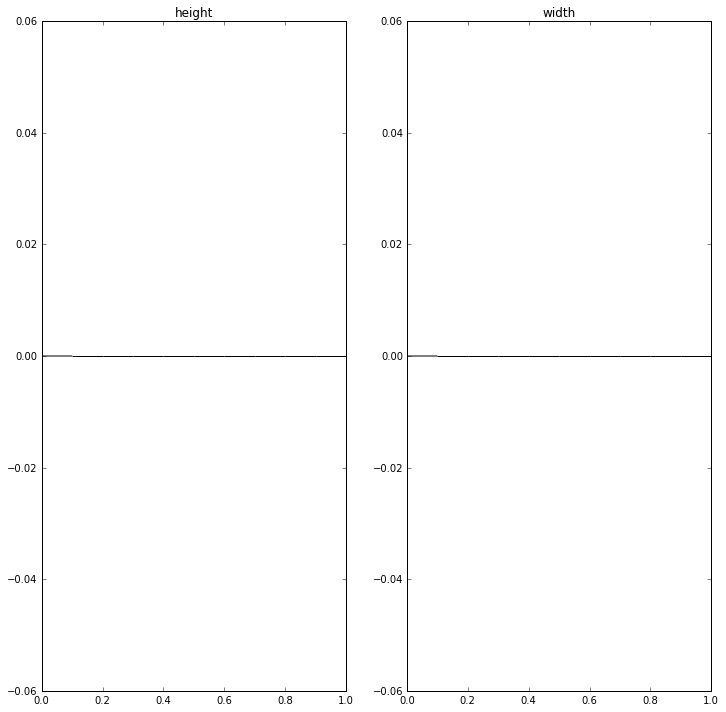

ValueError: zero-size array to reduction operation maximum which has no identity

In [169]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

fig, ax = plt.subplots(1,2,figsize=(12,12))
ax[0].hist(np.array(wbc_height))
ax[0].set_title('height')
ax[1].hist(np.array(wbc_width))
ax[1].set_title('width')
plt.show()
print(np.array(wbc_height).max())
print(np.array(wbc_width).max())
print(stats.mode(np.array(wbc_height)))
print(stats.mode(np.array(wbc_width)))
print(stats.percentileofscore(np.array(wbc_height), 130))
counts, vals = np.histogram(np.array(wbc_height))
max_id = counts.argmax()
print('mode', vals[max_id])
print('percentage', (float(counts.max()) / float(counts.sum())) * 100)
counts.sum()

# Add files from Bram

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import scipy.misc as misc

In [4]:
amref_labels = json.load(open('../../../data/MALARIA PARASITES THICK FILMS/annotation/labels.json','rb'))


In [6]:
path = '../../../data/MALARIA PARASITES THICK FILMS/p. falciparum thick/' #P. falciparum, Field stain thick x1000/'
# path = '../../data/MALARIA PARASITES THICK FILMS/p. falciparum thick/P. falciparum High count, Field stain thick x1000'

In [8]:
wbc, pf = 0, 0
for i in range(17):
    wbc_labels.append({u'annotations': [],
                        u'class': u'image',
                        u'filename': u'../images/'})
    filepath = amref_labels[i]['filename'].split('/')[-2:]
    wbc_labels[-1]['filename'] += str(filepath[1])
    
    img = misc.imread(os.path.join(path, str(filepath[0]), str(filepath[1])))
    original_shape = img.shape
    
    for anno in amref_labels[i]['annotations']:  
#         print('anno', anno)
        if np.floor(anno['x']) > 200.0 and np.floor(anno['x'])  < original_shape[1] - 200.0:
            wbc_labels[-1]['annotations'].append({u'class': None,
                                                  u'height': 0.0,
                                                  u'id': u'Nat',
                                                  u'type': u'rect',
                                                  u'width': 0.0,
                                                  u'x': 0.0,
                                                  u'y': 0.0})
            
            wbc_labels[-1]['annotations'][-1]['class'] = anno['class']
            if '(heavy parasitaemia)' in str(filepath[1]): 
                if str(anno['class']) == 'WBC':
                    wbc += 1
                    wbc_labels[-1]['annotations'][-1]['x'] = np.floor(anno['x']) - 250.0 + 60.0
                    wbc_labels[-1]['annotations'][-1]['y'] = np.floor(anno['y']) + 60.0
                    wbc_labels[-1]['annotations'][-1]['height'] = 150.0
                    wbc_labels[-1]['annotations'][-1]['width'] = 150.0
                elif str(anno['class']) == 'Falciparum':
                    pf += 1
                    wbc_labels[-1]['annotations'][-1]['x'] = np.floor(anno['x']) - 250.0 + 30.0
                    wbc_labels[-1]['annotations'][-1]['y'] = np.floor(anno['y']) + 30.0
                    wbc_labels[-1]['annotations'][-1]['height'] = 50.0
                    wbc_labels[-1]['annotations'][-1]['width'] = 50.0
            else:
                if str(anno['class']) == 'WBC':
                    wbc += 1
                    wbc_labels[-1]['annotations'][-1]['x'] = np.floor(anno['x']) - 250.0 + 60.0
                    wbc_labels[-1]['annotations'][-1]['y'] = np.floor(anno['y']) + 60.0 
                    wbc_labels[-1]['annotations'][-1]['height'] = 280.0
                    wbc_labels[-1]['annotations'][-1]['width'] = 280.0
                elif str(anno['class']) == 'Falciparum':
                    pf += 1
                    wbc_labels[-1]['annotations'][-1]['x'] = np.floor(anno['x']) - 250.0 + 30.0
                    wbc_labels[-1]['annotations'][-1]['y'] = np.floor(anno['y']) + 30.0 
                    wbc_labels[-1]['annotations'][-1]['height'] = 130.0
                    wbc_labels[-1]['annotations'][-1]['width'] = 130.0
                
#         print('new', wbc_labels[-1]['annotations'][-1])
    print(len(amref_labels[i]['annotations']))
    print(len(wbc_labels[-1]['annotations']))
    print('=====================================')
print(wbc, pf)

32
28
37
32
31
29
25
25
32
32
23
22
32
28
25
22
19
18
24
23
34
33
9
8
49
49
56
52
64
58
103
84
92
86
(66, 524)


In [7]:
with open('../../../data/datasetQuinn/annotation2/datasetquinn_amref_every_label.json', 'w') as fp:
    json.dump(wbc_labels, fp)

NameError: name 'wbc_labels' is not defined

# Make train/test list

In [1]:
import json
fileobj = open('../../../data/datasetQuinn/annotation2/datasetquinn_amref_every_label.json', 'rb')
labels = json.load(fileobj)

In [3]:
import os
root_dir = '../../data/datasetQuinn/curated'
bad_dir = os.path.join(root_dir, 'bad')
maybe_dir = os.path.join(root_dir, 'maybe')
good_dir = os.path.join(root_dir, 'good')

# os.makedirs(root_dir)
for item in labels:
    filename = item['filename'].split('/')[-2:]
    img = misc.imread(os.path.join('../../data/datasetQuinn/', str(filename[0]), str(filename[-1])))
    for anno in item['annotations']:
        if str(anno['class'])  == 'Bad':
            if not os.path.exists(bad_dir):
                os.makedirs(bad_dir)
            misc.imsave(os.path.join(bad_dir, str(filename[-1])), img)
        elif str(anno['class']) == 'Good':
            if not os.path.exists(good_dir):
                os.makedirs(good_dir)
            misc.imsave(os.path.join(good_dir, str(filename[-1])), img)
        elif str(anno['class']) == 'Maybe':
            if not os.path.exists(maybe_dir):
                os.makedirs(maybe_dir)
            misc.imsave(os.path.join(maybe_dir, str(filename[-1])), img)
        elif str(anno['class']) not in ['Falciparum', 'WBC', 'DEBRIS', 'Debris']:
            print('Hasnt been assessed yet! {}'.format(str(filename[-1])))
            print(str(anno['class']))

NameError: name 'misc' is not defined

In [220]:
from glob import glob
from sklearn.cross_validation import train_test_split

# files = [fn for fn in glob(os.path.join(root_dir, '*')) 
#          if not os.path.basename(fn).startswith('eph')]
maybes = [fn.split('/')[-1] for fn in glob(os.path.join(maybe_dir, '*'))]
goods = [fn.split('/')[-1] for fn in glob(os.path.join(good_dir, '*'))]

entire_set = goods + maybes

train, test = train_test_split(entire_set, test_size=0.1)
train[:10]


['plasmodium-1365.jpg',
 'plasmodium-0984.jpg',
 'plasmodium-0693.jpg',
 'plasmodium-2641.jpg',
 'plasmodium-1665.jpg',
 'plasmodium-2457.jpg',
 'plasmodium-0085.jpg',
 'plasmodium-0593.jpg',
 'plasmodium-2327.jpg',
 'plasmodium-0424.jpg']

In [4]:
import pickle
pickle.dump(train, open('../../data/datasetQuinn/annotation2/train_list.pickle', 'wb'))
pickle.dump(test, open('../../data/datasetQuinn/annotation2/test_list.pickle', 'wb'))


NameError: name 'train' is not defined

# Plot annoations

In [56]:
from numpy import random
def plt_bboxes_original(img, classes, bboxes, saveto, figsize=(10,10), linewidth=1.5):
    """Visualize bounding boxes. Largely inspired by SSD-MXNET!
    """
    fig = plt.figure(figsize=figsize)
    plt.imshow(img)
    height = img.shape[0]
    width = img.shape[1]
    colors = dict()
    # handles = []
    for i in range(classes.shape[0]):
        cls_id = int(classes[i])
        colors[cls_id] = (random.random(), random.random(), random.random())
        if bboxes[i].any():
            for j in range(len(bboxes[i])):
#                 ymin = int(bboxes[i][j, 0] * height)
#                 xmin = int(bboxes[i][j, 1] * width)
#                 ymax = int(bboxes[i][j, 2] * height)
#                 xmax = int(bboxes[i][j, 3] * width)
                ymin = int(bboxes[i][j, 0])
                xmin = int(bboxes[i][j, 1])
                ymax = int(bboxes[i][j, 2])
                xmax = int(bboxes[i][j, 3])
#                 print(xmin, xmax, ymin, ymax)
                rect = plt.Rectangle((xmin, ymin), xmax - xmin,
                                     ymax - ymin, fill=False,
                                     label=None,
                                     edgecolor=colors[cls_id],
                                     linewidth=linewidth)

                plt.gca().add_patch(rect)
            # h, = plt.plot(0., 0., label=str(i), color=colors[cls_id])
            # handles.append(h)
            # plt.legend(handles=handles, labels=[str(i) for i in classes])
    plt.show()

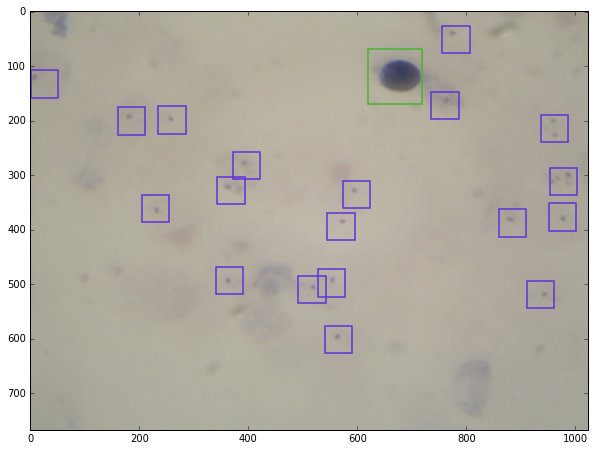

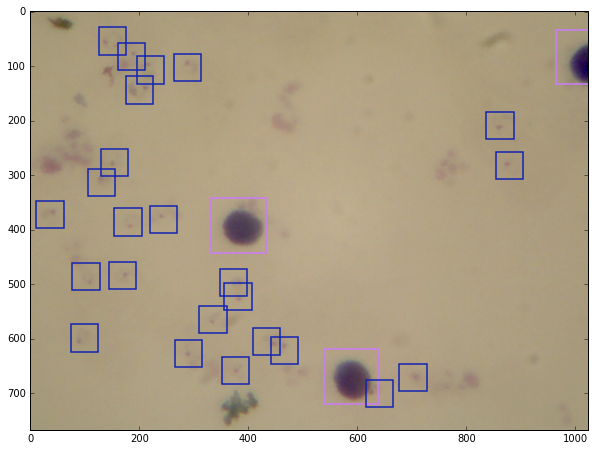

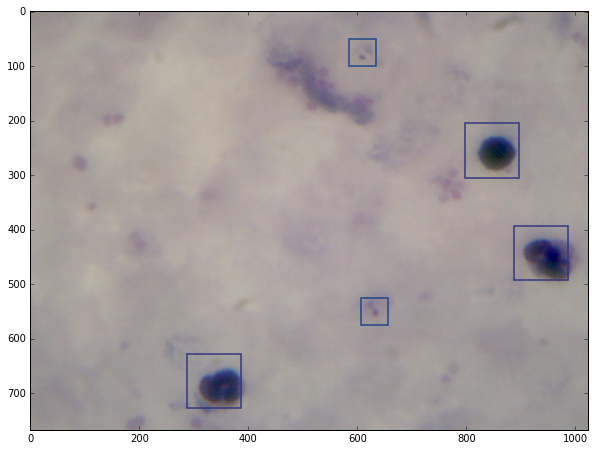

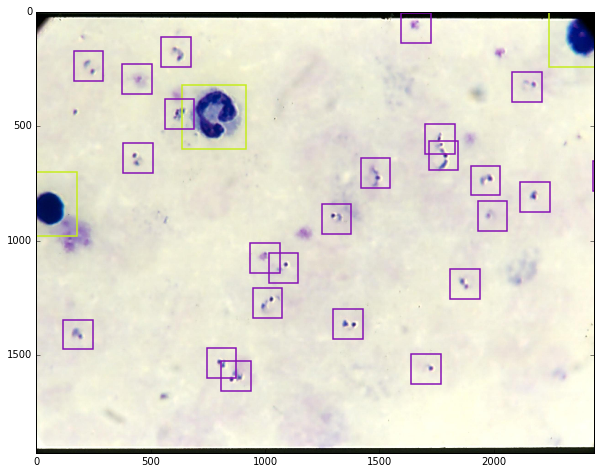

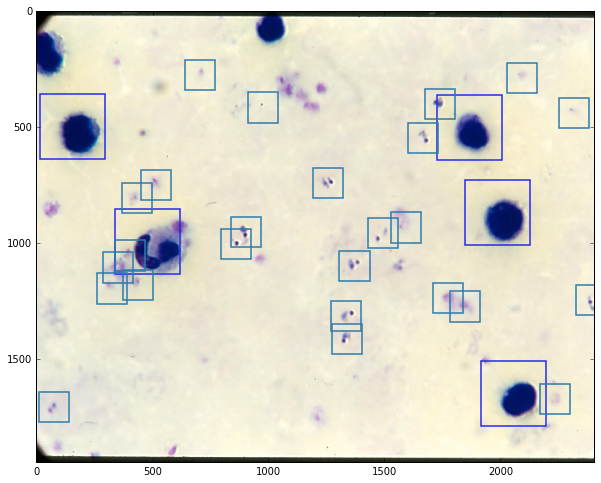

...

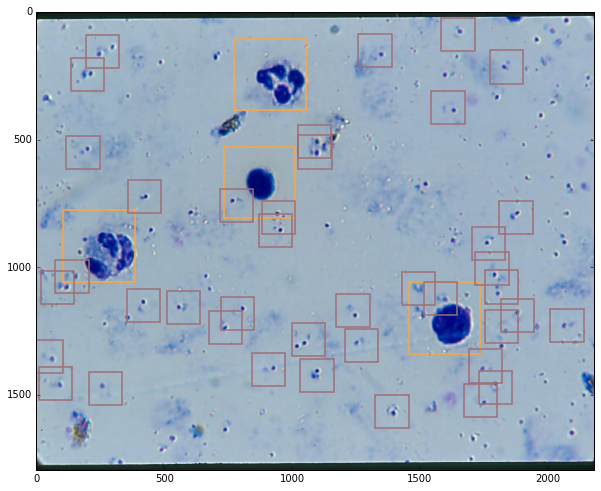

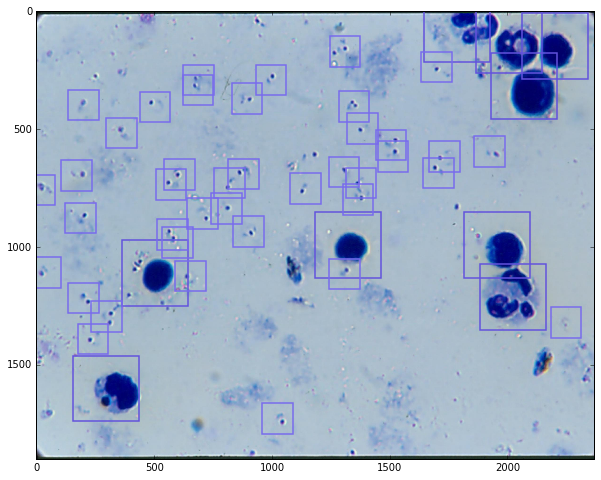

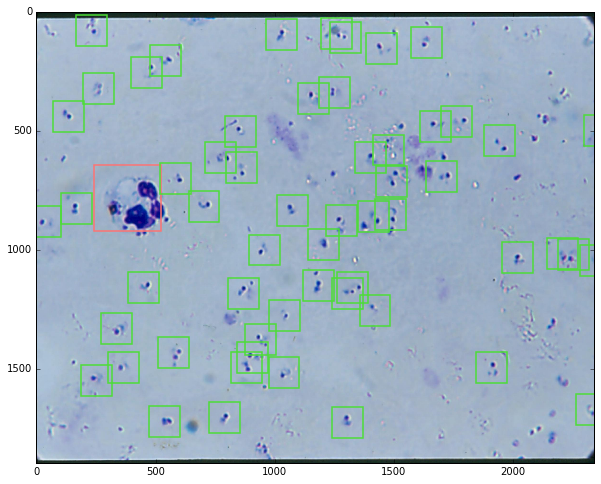

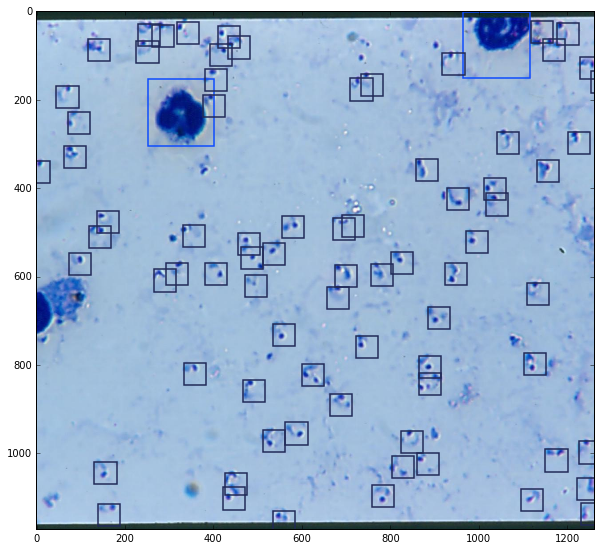

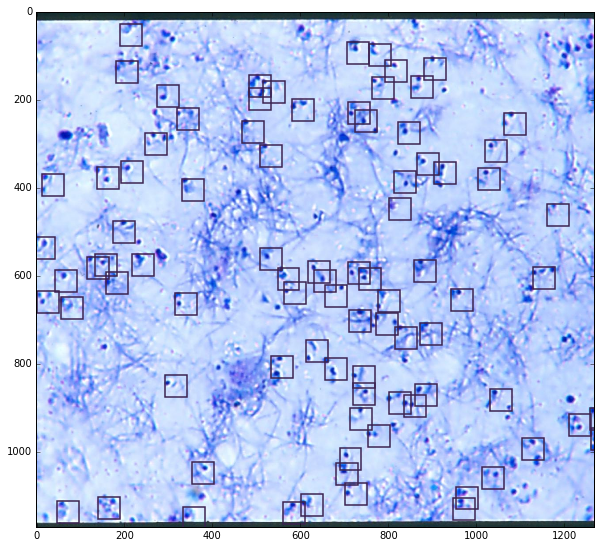

In [59]:
path = '/home/nat/PycharmProjects/orikami/data/datasetQuinn/images/'
for i, item in enumerate(wbc_labels):
    if i < 2700:
        continue
    filename = item['filename'].split('/')[-2:]
#     print(filename)
    img = misc.imread(os.path.join(path, str(filename[1])))
    wbc, fal = [], []
    for anno in item['annotations']:
        xmin, xmax = int(anno['x']  - (anno['width'] / 2.)), int(anno['x']  + (anno['width'] / 2.))
        ymin, ymax = int(anno['y']  - (anno['height'] / 2.)), int(anno['y']  + (anno['height'] / 2.))
        if str(anno['class']) == 'WBC':
            wbc.append([ymin, xmin, ymax, xmax])
        elif str(anno['class']) == 'Falciparum':
            fal.append([ymin, xmin, ymax, xmax])
    bboxes = [np.array(wbc), np.array(fal)]
    
    plt_bboxes_original(img[:, :, :], np.array([1, 2]), bboxes, None, figsize=(10,10), linewidth=1.5)

# Preprocessing

In [31]:
data_path = '../../data/datasetQuinn/images'
# from IPython.display import Image
from PIL import ImageEnhance, Image, ImageOps
from scipy import stats

im = Image.open(os.path.join(data_path, train[10]))
# enh = ImageEnhance.Contrast(im)
# shp = ImageEnhance.Sharpness(im)
mask = img[:, :, -1] > 110.
mask = Image.fromarray(mask, 'L')
eq = ImageOps.equalize(im, mask)
auto = ImageOps.autocontrast(im, cutoff=1.1)

im.show('original')
# eq.show('equalize')
auto.show('auto contrast')
# auto.imsave()
# enh.enhance(2.5).show("30% more contrast")
# shp.enhance(10.).show('sharpened')

NameError: name 'train' is not defined

29.1455748114
('this one', 190)


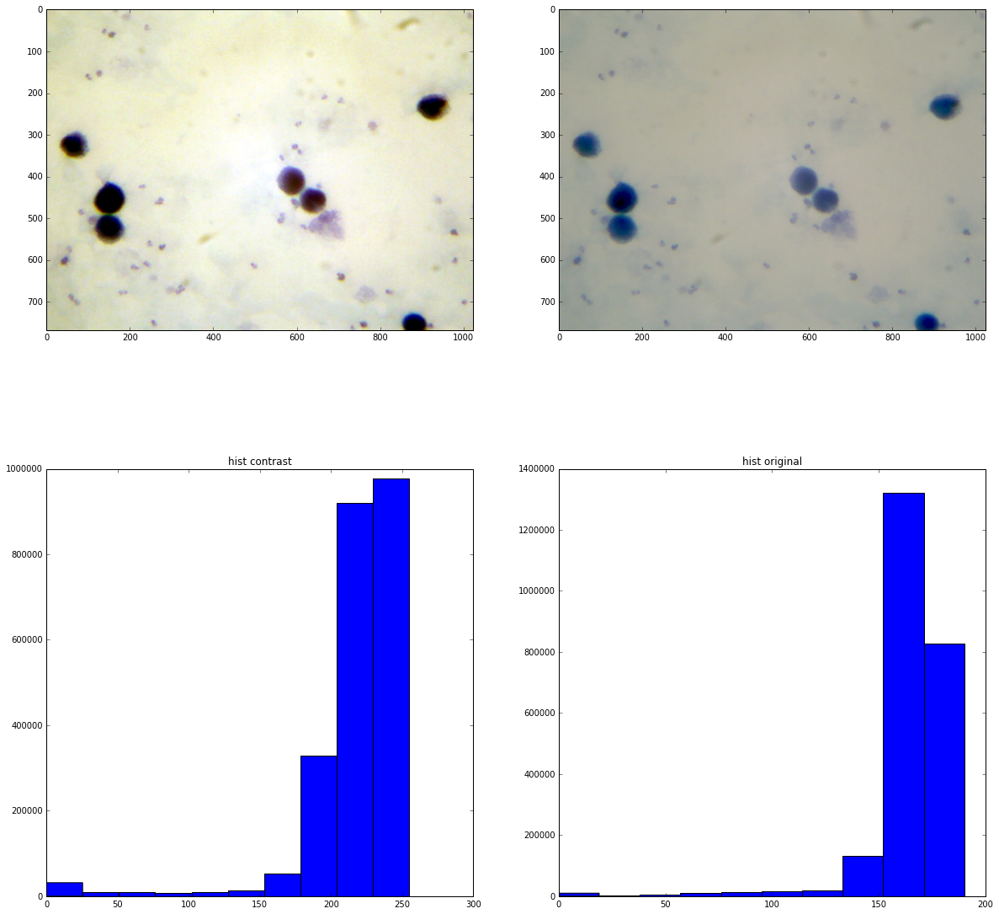

20.9062449924
('this one', 205)


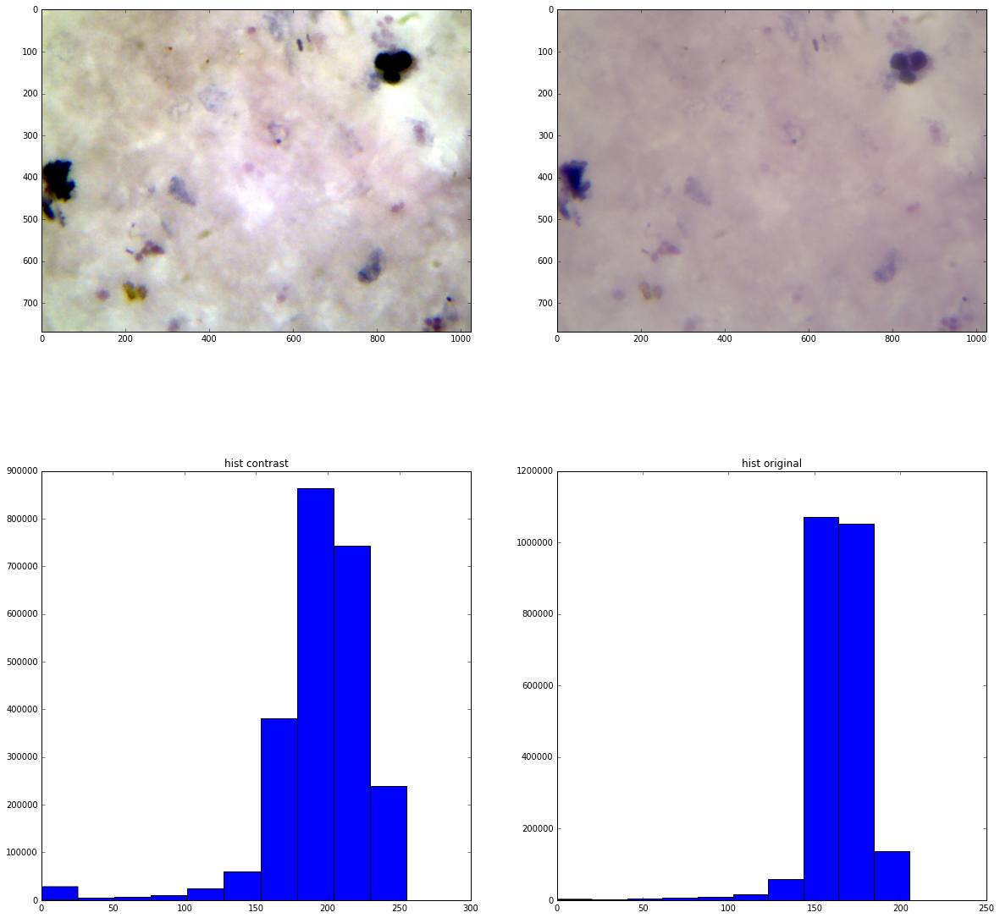

-1.162214301


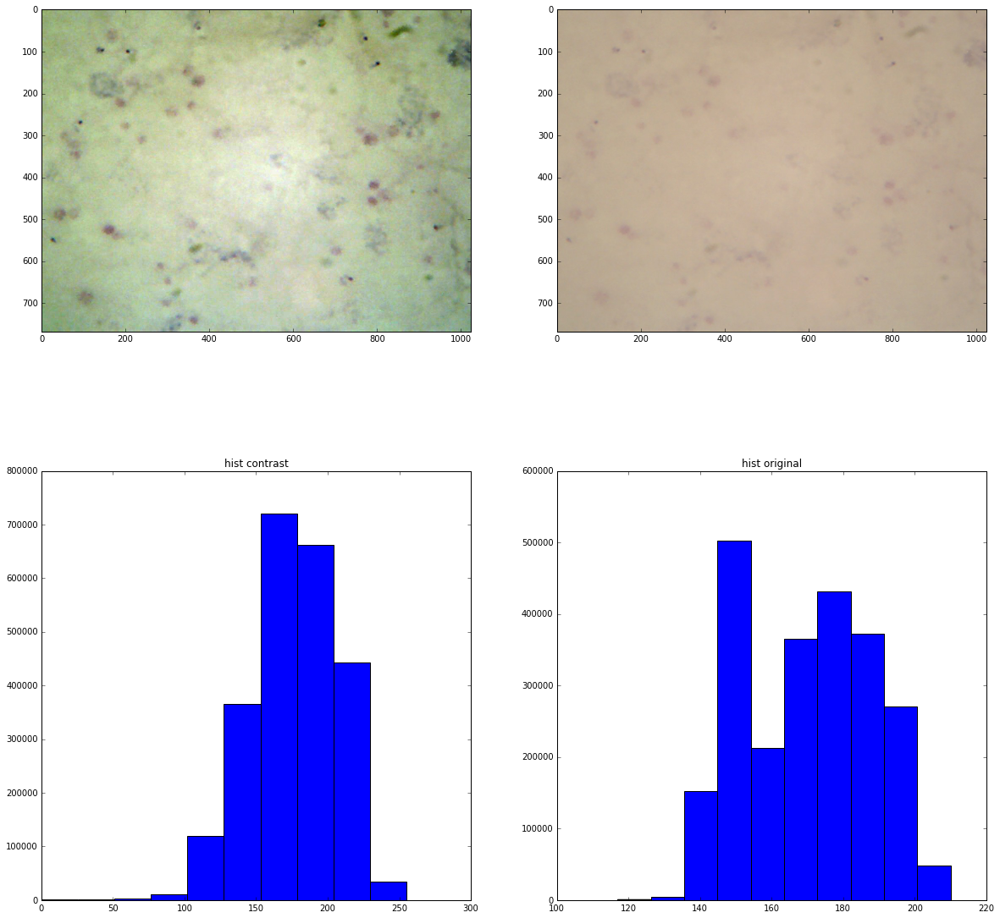

4.54538335511
('this one', 191)


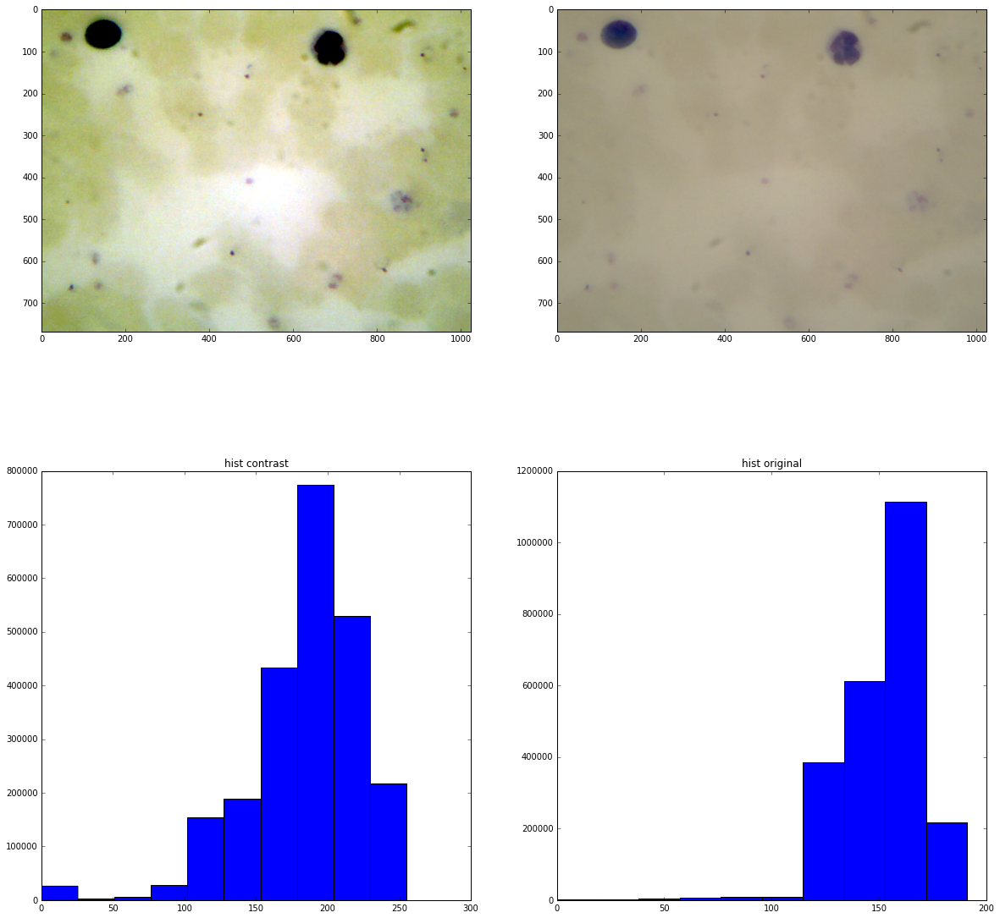

-0.965468620087


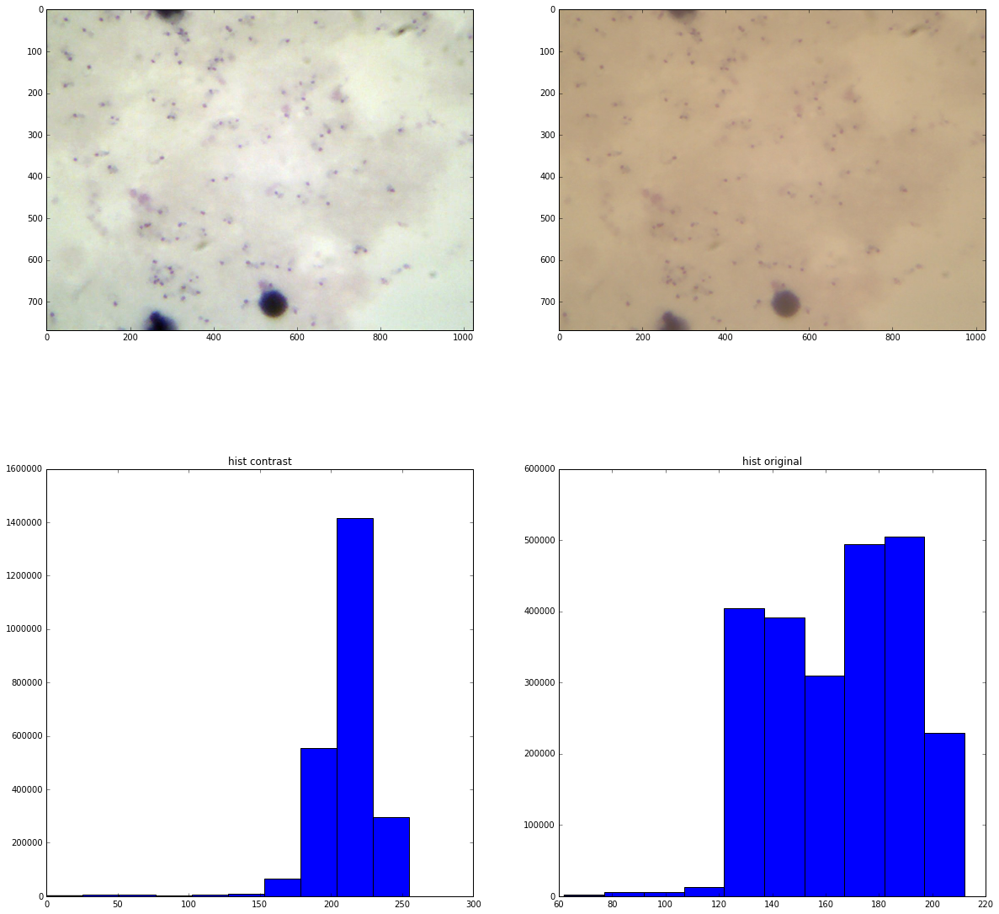

-1.24652566231


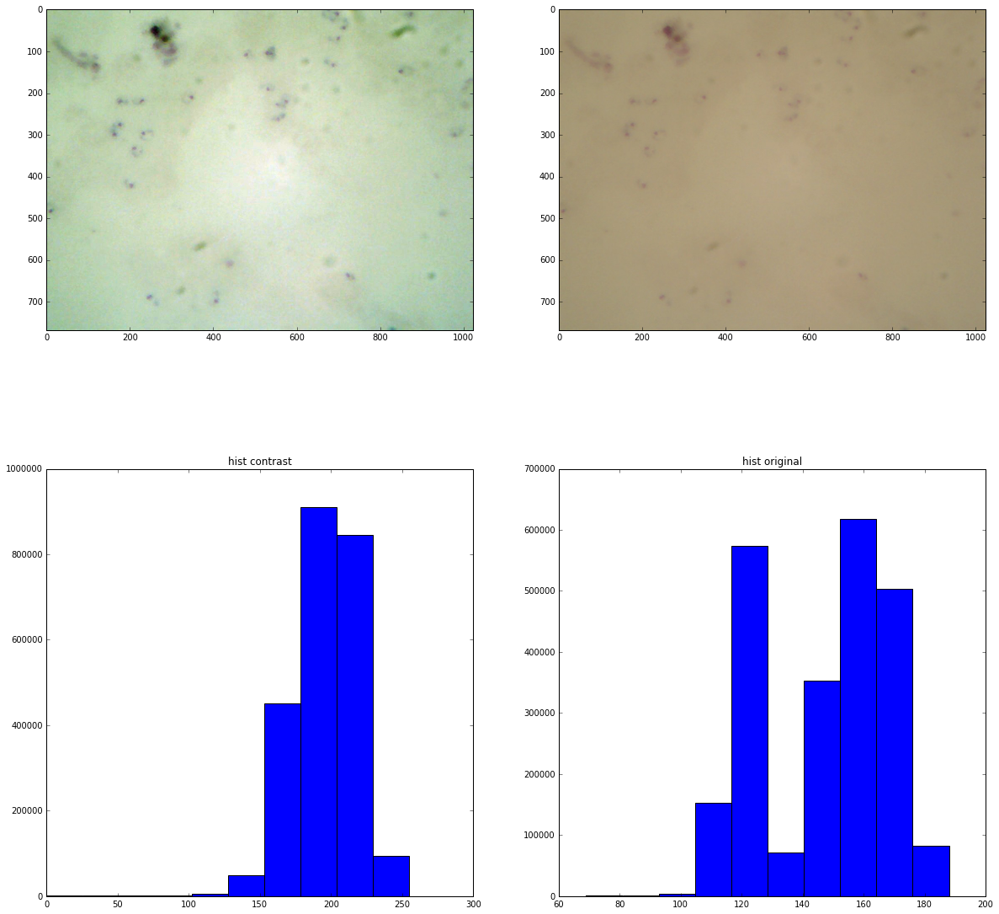

1.33051727155
('this one', 205)


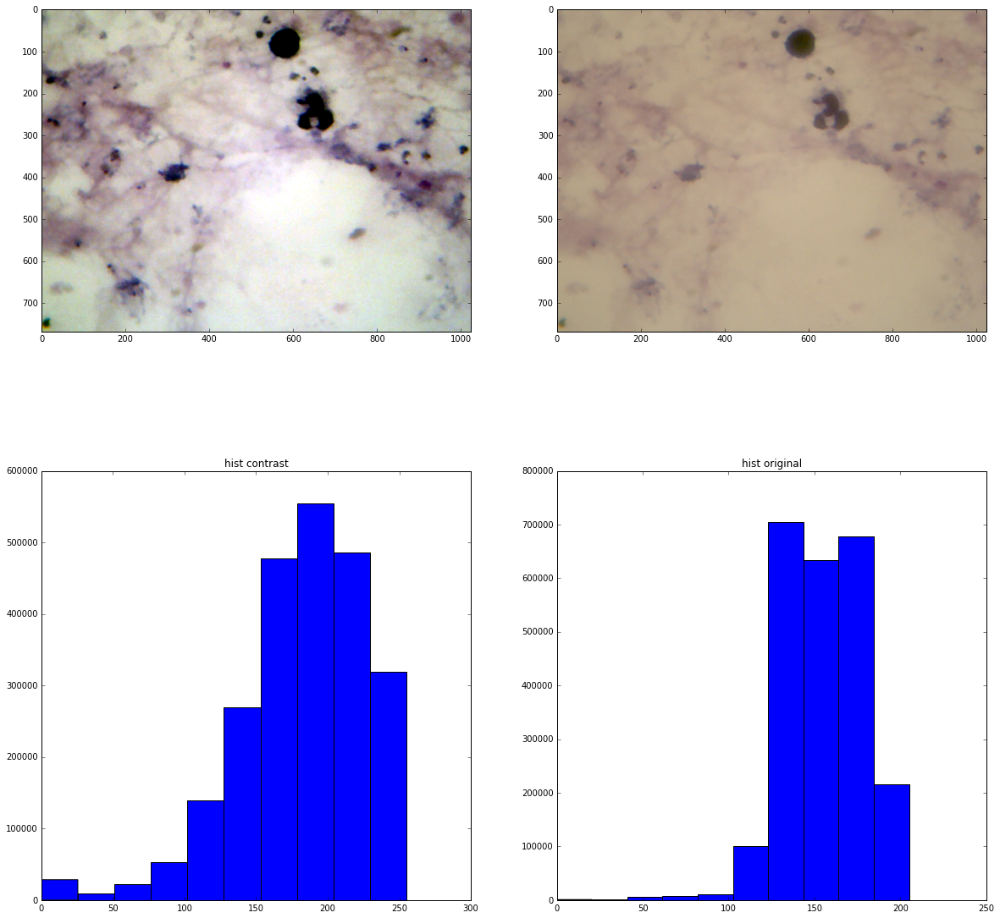

-0.813424544384


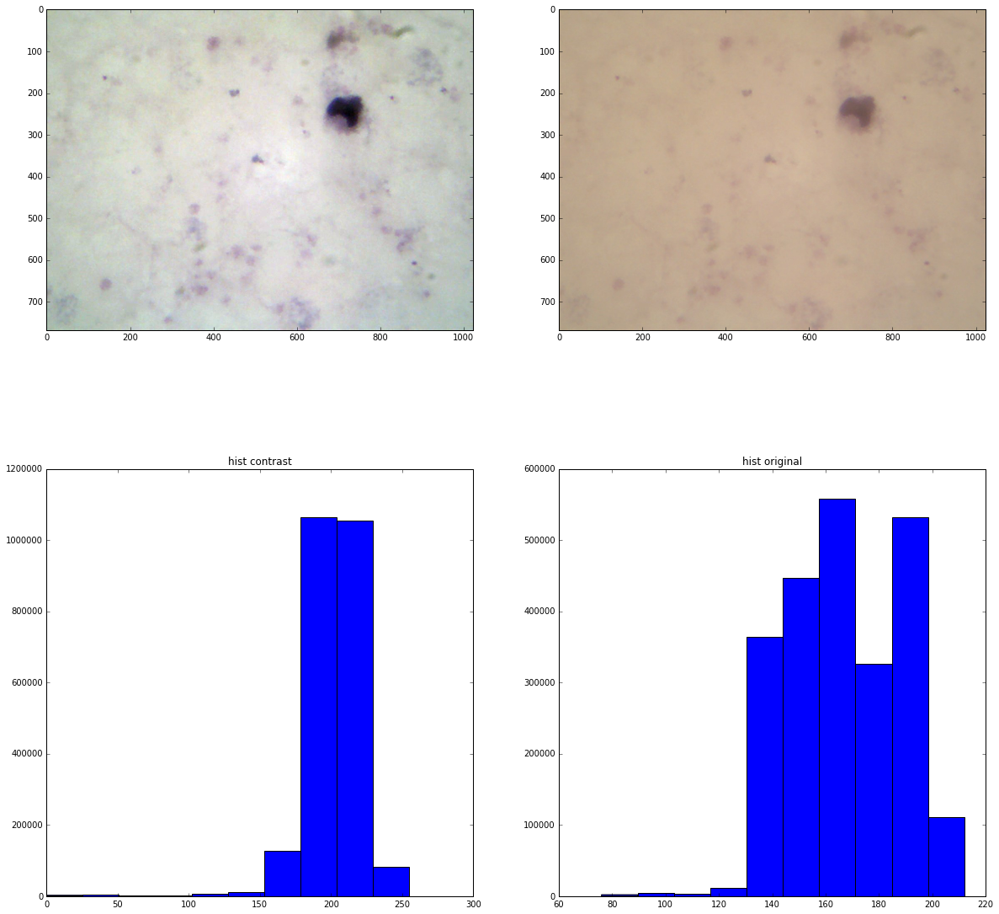

4.56933076116


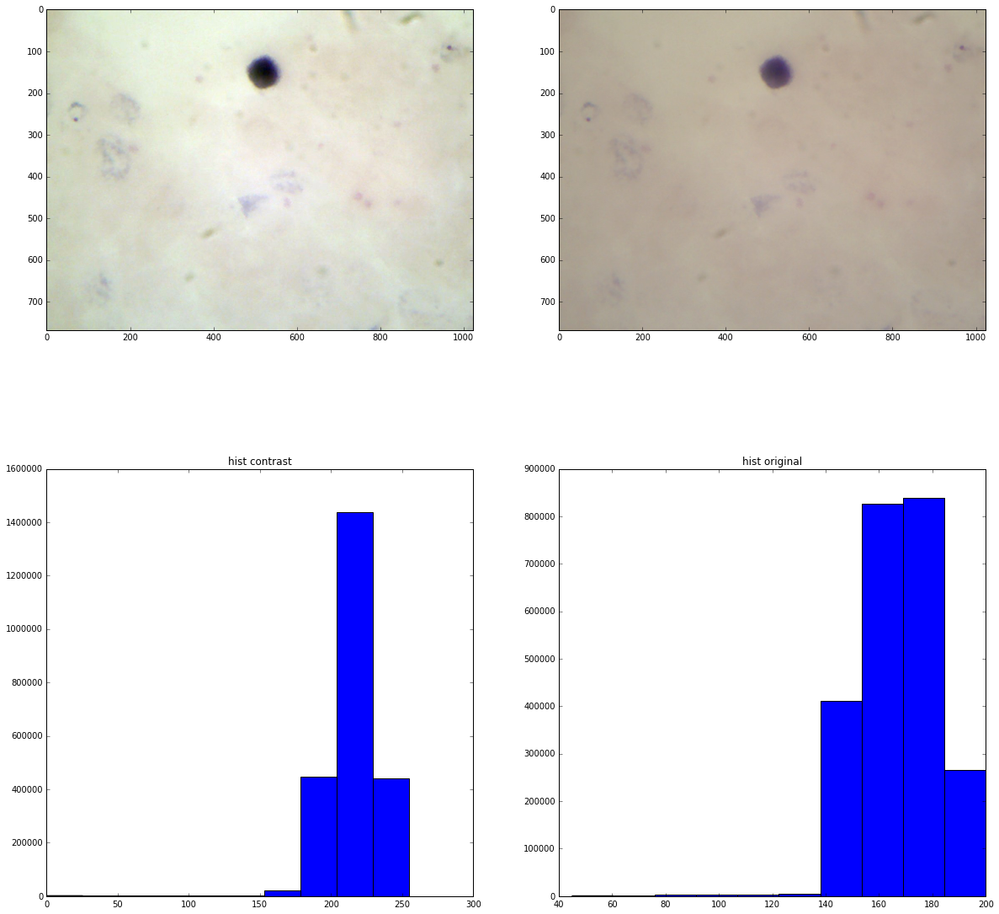

0.0835403829826
('this one', 195)


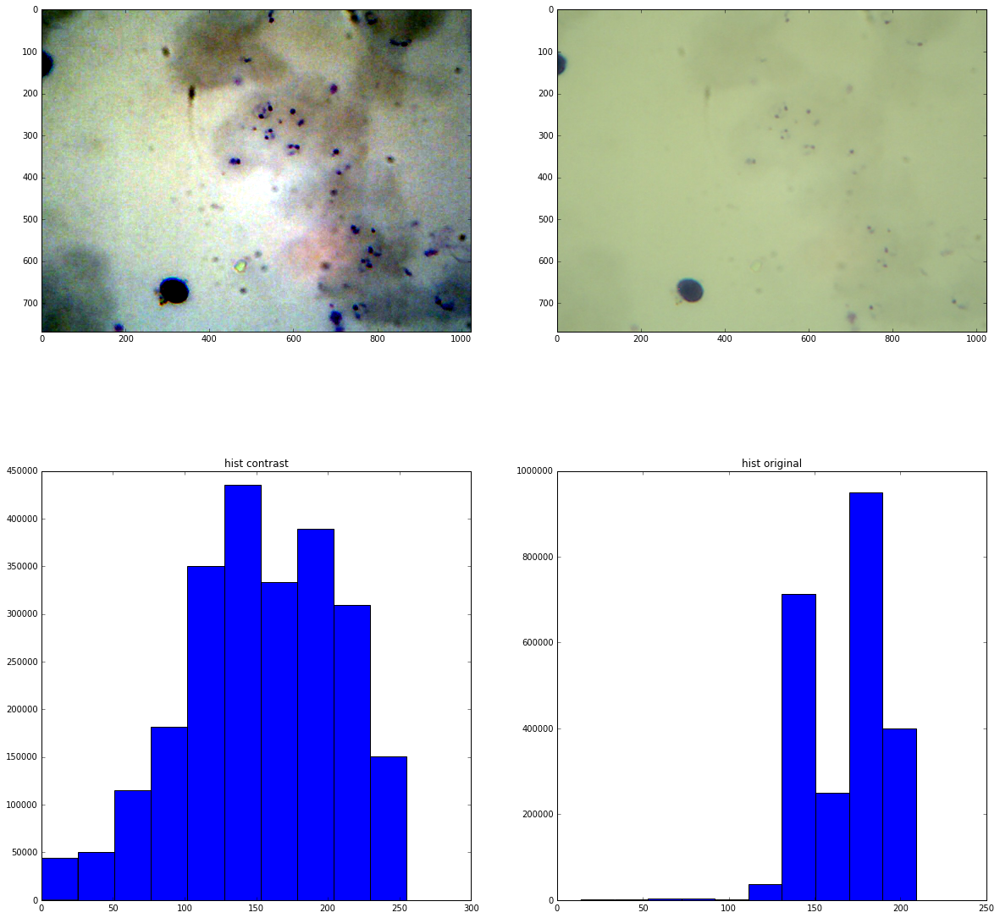

-0.438304762261
('this one', 185)


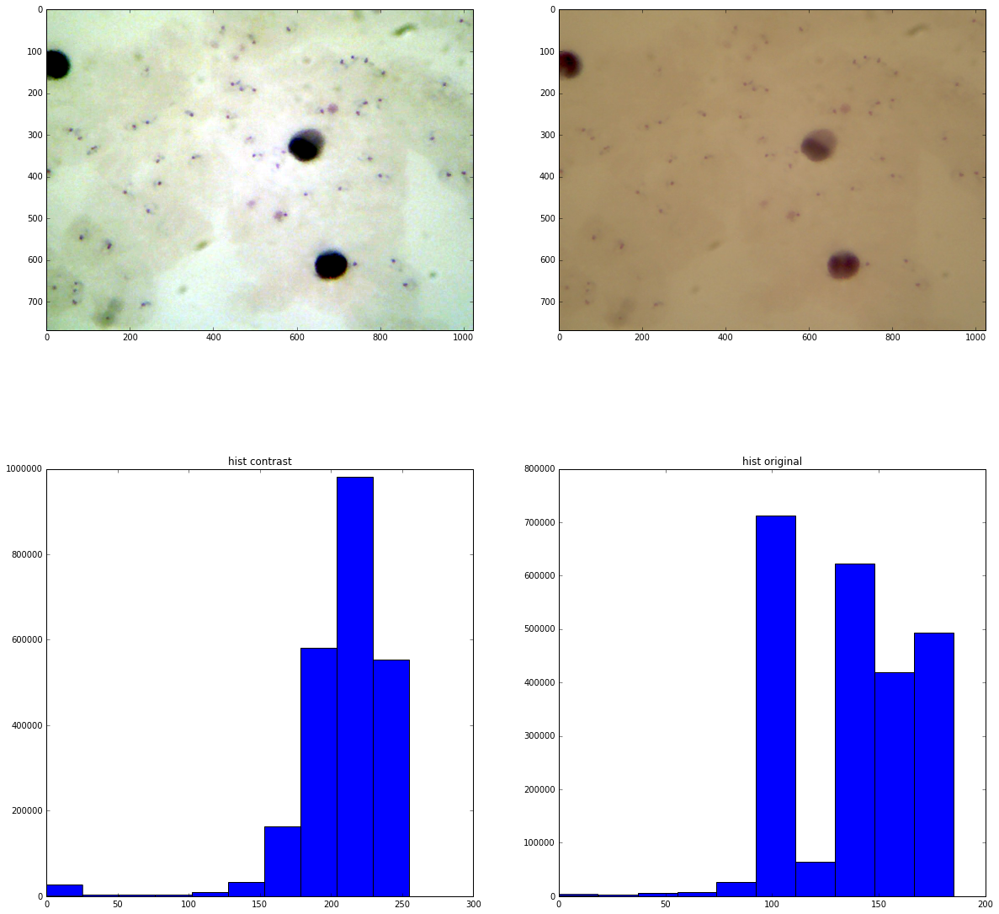

29.6861794947
('this one', 195)


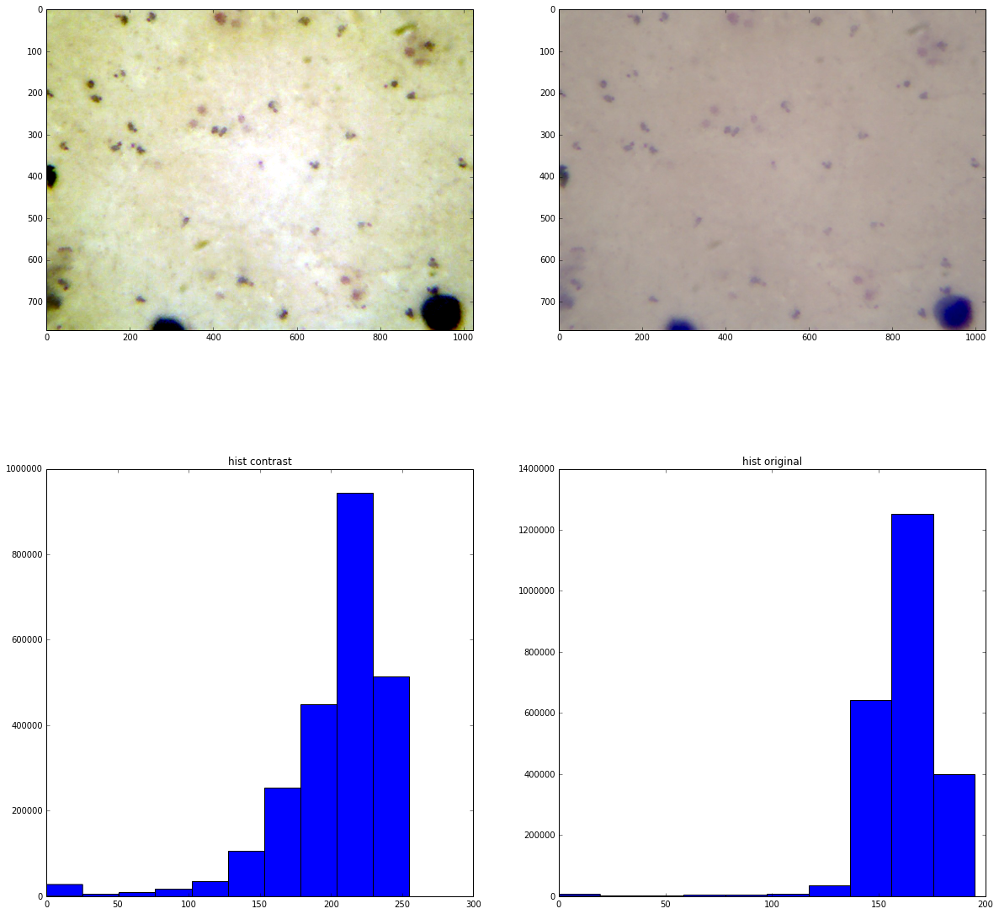

-1.30734668507


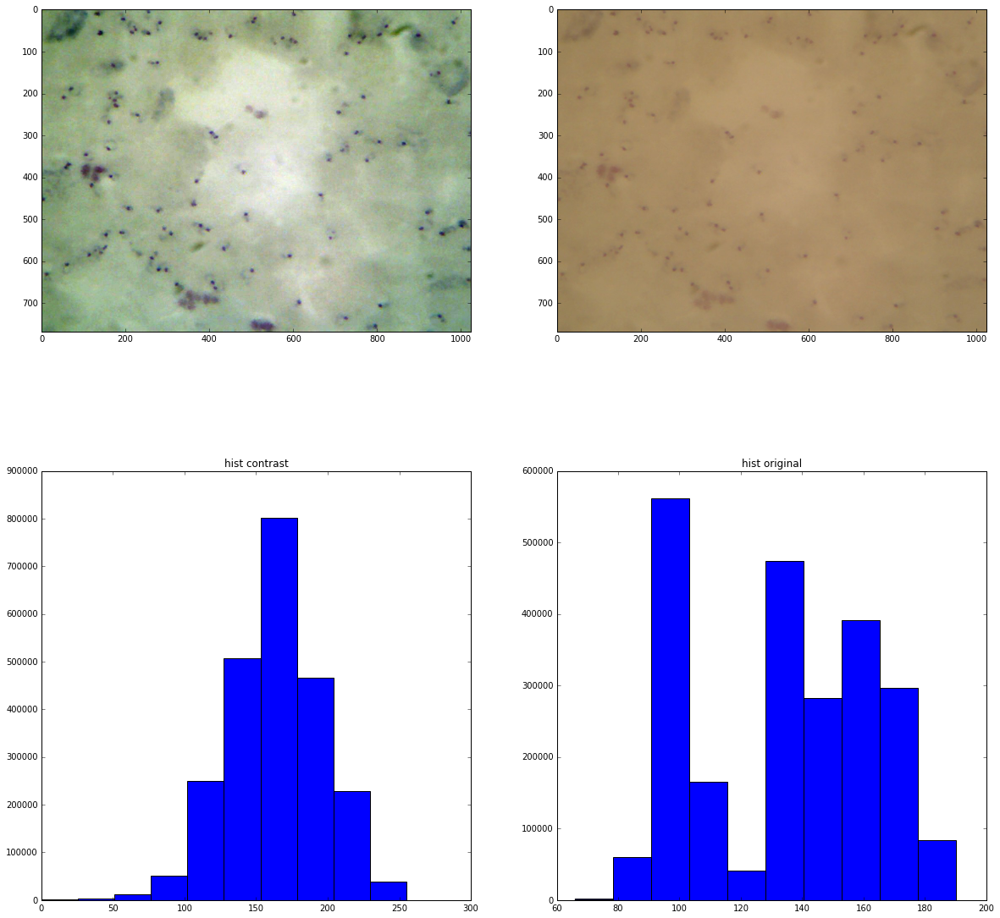

0.771047135748


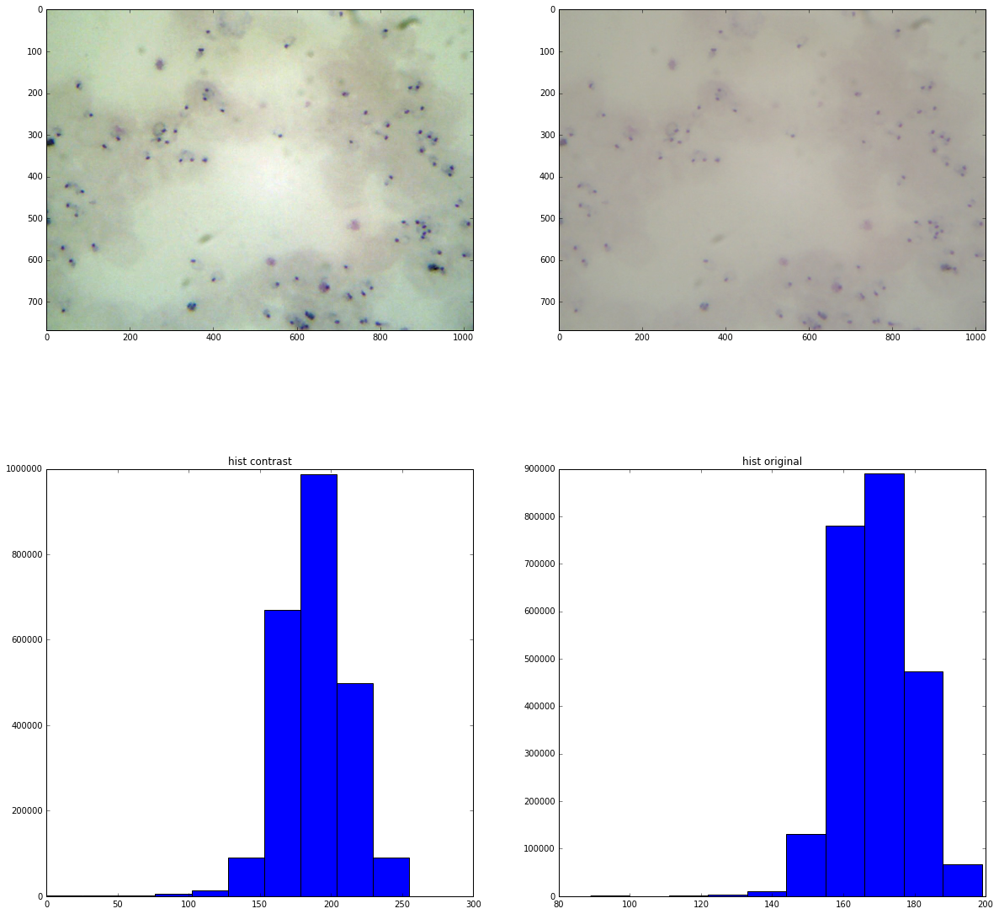

3.98078295074
('this one', 207)


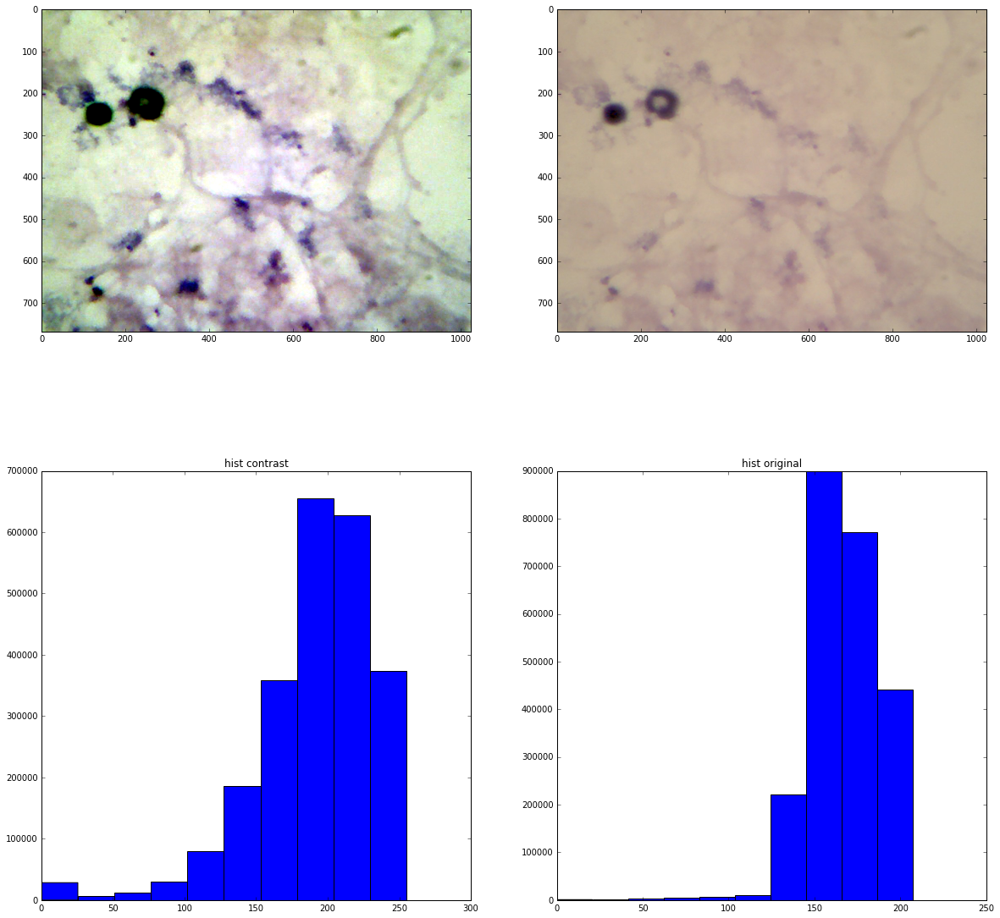

-0.59215983096
('this one', 169)


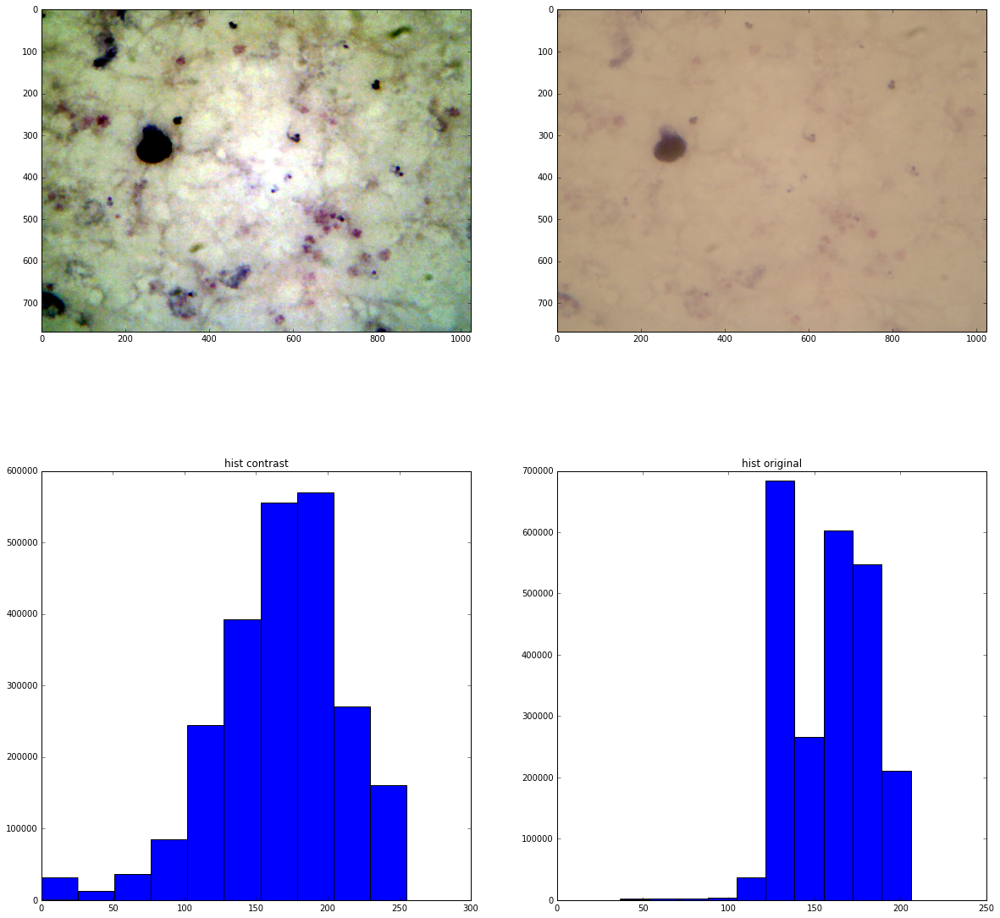

-0.948125284064


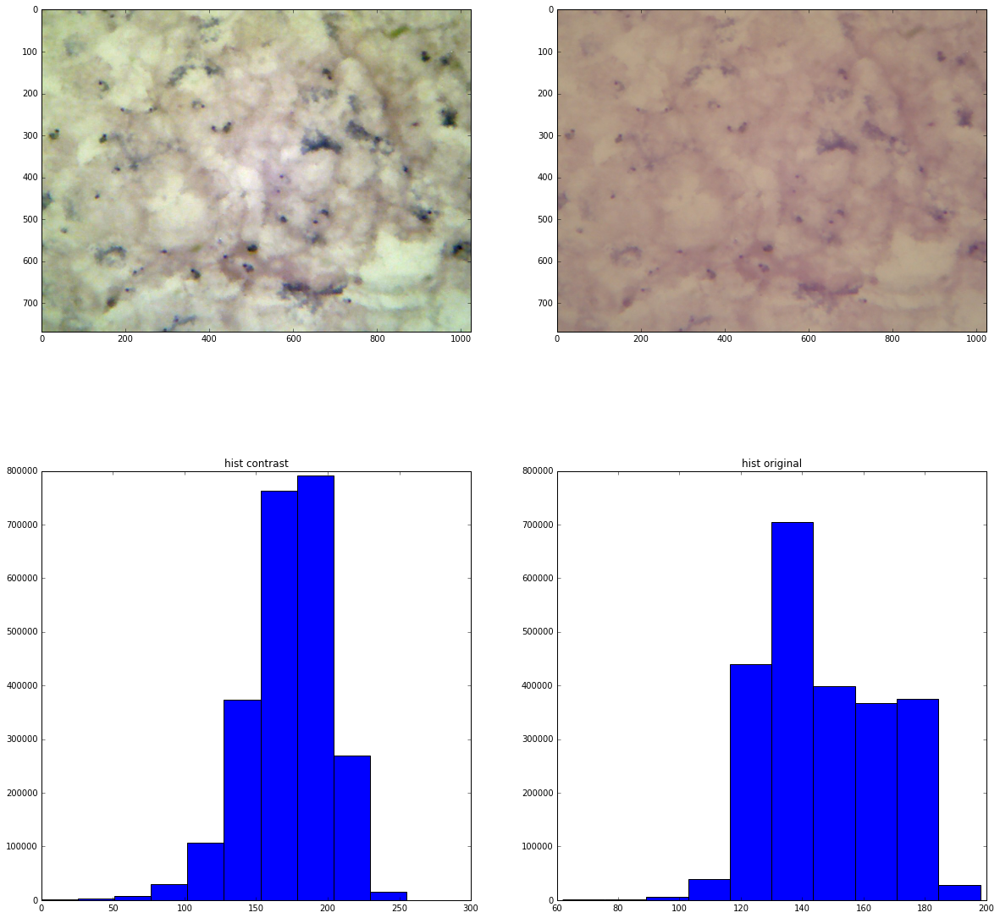

42.9041031869
('this one', 190)


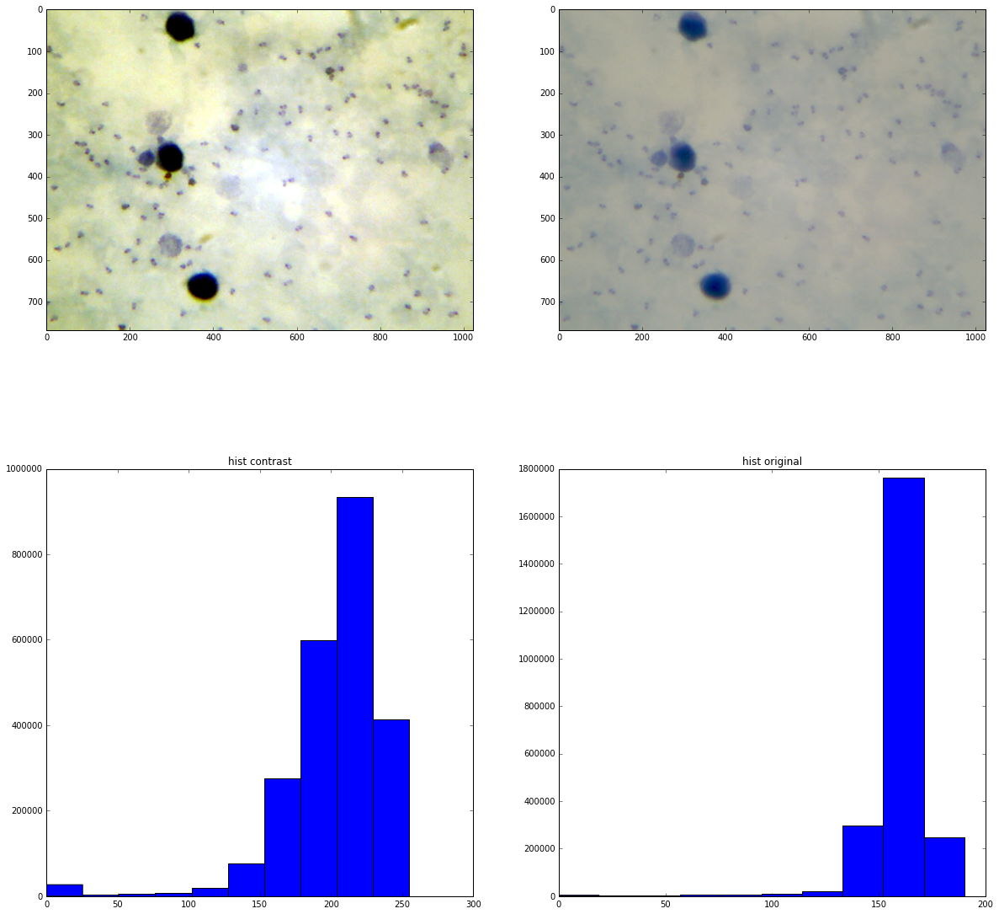

-1.37101178664


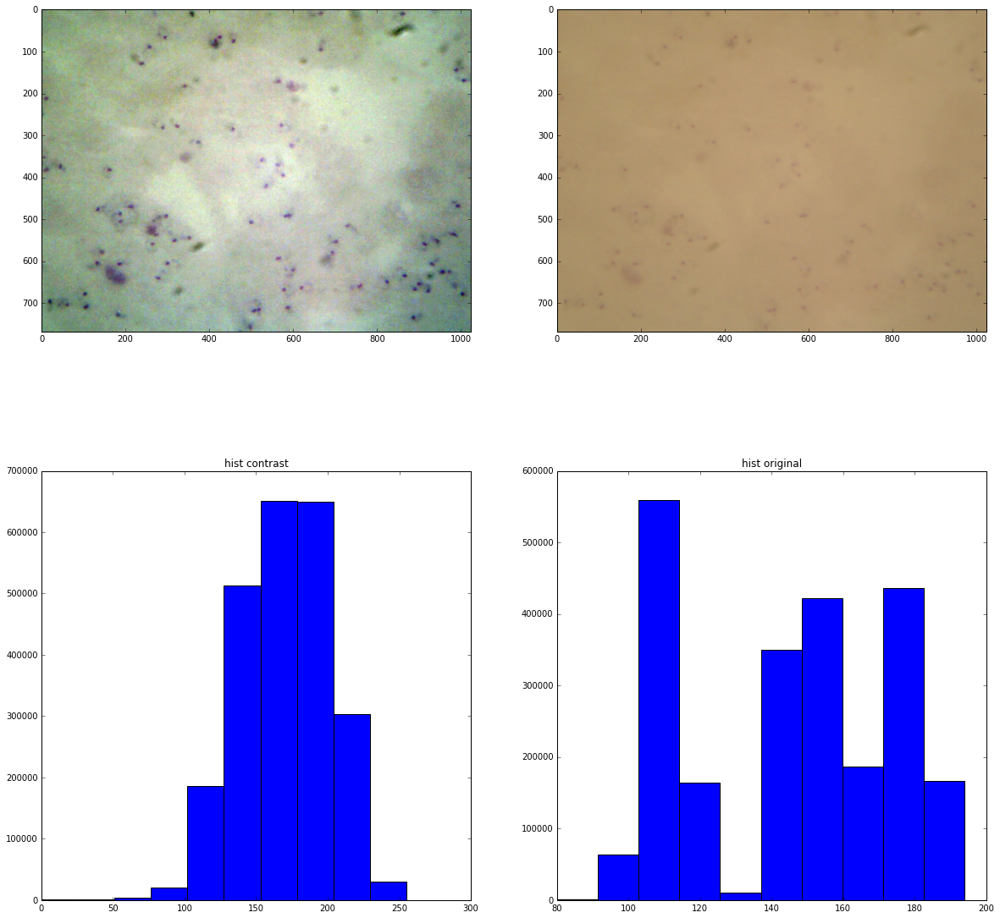

9.03850008964
('this one', 192)


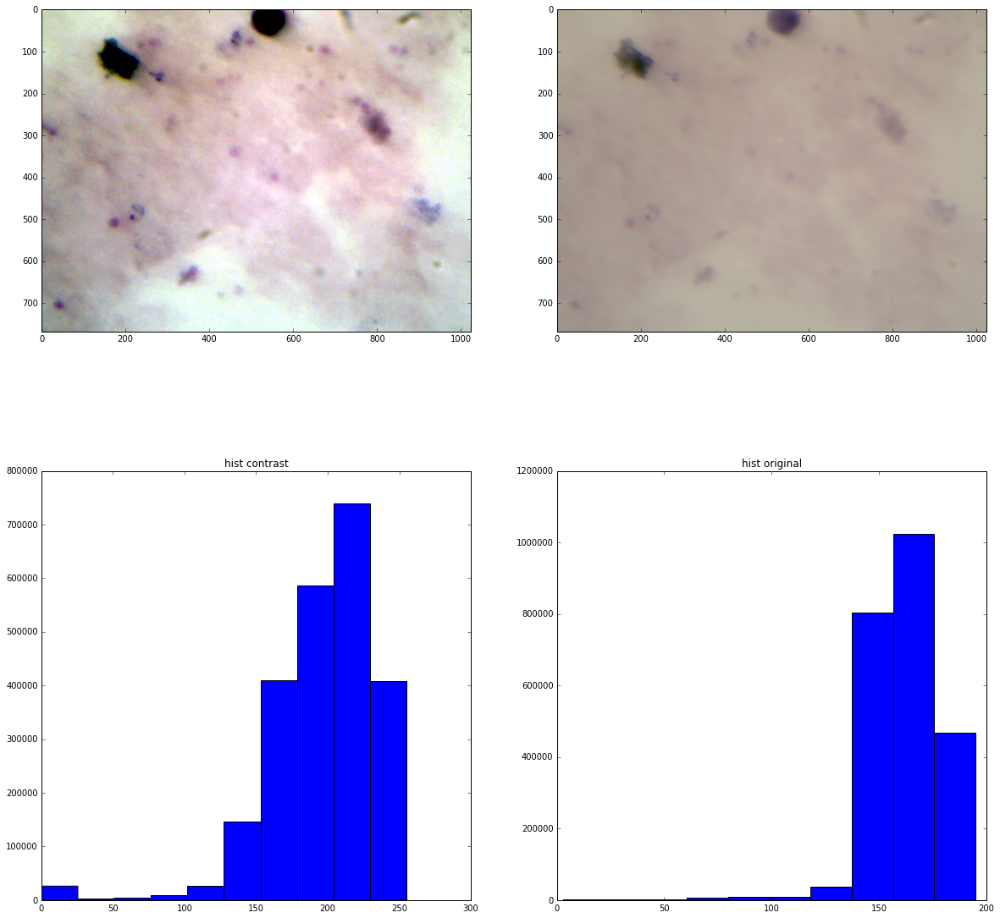

In [298]:
train = pickle.load(open('../../data/datasetQuinn/annotation2/train_list.pickle', 'rb'))
for f in sorted(train[1200:1220]):
    im = Image.open(os.path.join(data_path, f))
    print stats.kurtosis(np.array(im).flatten())
    if np.array(im).max() - np.array(im).min() >= 160.:
        con = ImageOps.autocontrast(im, cutoff=1.)
        print('this one', np.array(im).max() - np.array(im).min())
    else:
        con = ImageOps.autocontrast(im, cutoff=0.0)
        
    fig, ax = plt.subplots(2,2, figsize=(20, 20))
    ax = ax.flatten()
    ax[0].imshow(np.array(con))
    ax[1].imshow(np.array(im))
    ax[2].hist(np.array(con).flatten())
    ax[2].set_title('hist contrast')
    ax[3].hist(np.array(im).flatten())
    ax[3].set_title('hist original')
    plt.show('tight')
    
    

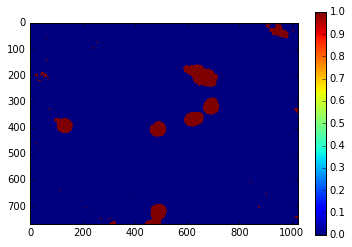

4.10035451253


In [106]:
plt.figure()
img = np.array(im)
blue = np.array(img[:, :, -1] < 140., dtype=np.float32)
red = np.array(img[:, :, 0] < 120., dtype=np.float32) 
# plt.hist(img[:, :, -1].flatten())
plt.imshow(red)
plt.colorbar()
plt.show()
print(stats.percentileofscore(img[:, :, -1].flatten(), 120))

# Make train/test folders in 'preprocess' folder

In [6]:
import pickle
from PIL import ImageEnhance, Image, ImageOps
root_dir = '../../data/datasetQuinn/curated'
train = pickle.load(open('../../../data/datasetQuinn/annotation2/train_list.pickle', 'rb'))
test = pickle.load(open('../../../data/datasetQuinn/annotation2/test_list.pickle', 'rb'))


In [300]:
train_path = os.path.join(root_dir, 'preprocess', 'train')
# os.makedirs(train_path)
for f in train:
    im = Image.open(os.path.join(data_path, f))
    
    
    
    if np.array(im).max() - np.array(im).min() >= 160.:
        con = ImageOps.autocontrast(im, cutoff=1.)
    else:
        con = ImageOps.autocontrast(im, cutoff=0.0)
    con.save(os.path.join(train_path, f[:-4]), format='JPEG', subsampling=0, quality=100)

In [301]:
test_path = os.path.join(root_dir, 'preprocess', 'test')
# os.makedirs(test_path)
for f in test:
    im = Image.open(os.path.join(data_path, f))
    if np.array(im).max() - np.array(im).min() >= 160.:
        con = ImageOps.autocontrast(im, cutoff=1.)
    else:
        con = ImageOps.autocontrast(im, cutoff=0.0)
    con.save(os.path.join(test_path, f[:-4]), format='JPEG', subsampling=0, quality=100)

# make ground truth dict

In [5]:
from scipy import misc
import pickle, os
from tqdm import tqdm
from PIL import Image

In [ ]:
fileobj = open('../../../data/datasetQuinn/annotation2/datasetquinn_amref_every_label.json', 'rb')
labels = json.load(fileobj)
train = pickle.load(open('../../../data/datasetQuinn/annotation2/train_list.pickle', 'rb'))
test = pickle.load(open('../../../data/datasetQuinn/annotation2/test_list.pickle', 'rb'))

In [6]:
'plasmodium-0000.jpg' in train

True

In [144]:
preprocess_dir = os.path.join('..', '..', '..', 'data', 'datasetQuinn', 'curated', 'preprocess')

In [14]:
os.makedirs(os.path.join(preprocess_dir, 'train0'))


OSError: [Errno 17] File exists: '../../../data/datasetQuinn/curated/preprocess/train0'

In [31]:
# count train & val labels
fp, wbc = 0, 0 
c = 0
for label in tqdm(labels): 
    f = str(label['filename'].split('/')[-1])
    if f in test:
        if not f.startswith('plasmodium'):
            c += 1
            for anno in label['annotations']:
                if str(anno['class']) == 'Falciparum':
                    fp += 1
                elif str(anno['class']) == 'WBC':
                    wbc += 1
                
print(fp, wbc, c)


100%|██████████| 2720/2720 [00:00<00:00, 219694.33it/s]

(40, 4, 1)


In [151]:
gt = {}
data_path = '../../../data/datasetQuinn/images'
for label in tqdm(labels): 
    f = str(label['filename'].split('/')[-1])

    if f in train:
        coordinates, objclass = [], []
        for anno in label['annotations']:
            # class
            if str(anno['class']) == 'Falciparum':
                objclass.append((1, 0))
            elif str(anno['class']) == 'WBC':
                objclass.append((0, 1))
            else:
                continue
            
            # coordinates
            xmin, xmax = int(anno['x'] - (anno['width'] / 2.)), int(anno['x'] + (anno['width'] / 2.))
            ymin, ymax = int(anno['y'] - (anno['height'] / 2.)), int(anno['y'] + (anno['height'] / 2.))
            coordinates.append((ymin, xmin, ymax, xmax))
        
        # make gt and save images
        src_image = misc.imread(os.path.join(preprocess_dir, 'train', f[:-4]))
        src_boxes = np.array(coordinates)
        src_objclass = np.array(objclass)
        
        images, annotations = crop_to_images(src_image, src_boxes, src_objclass, size=256)
        
        for i, (im, anno) in enumerate(zip(images, annotations)):
#             pil_im = Image.fromarray(im, 'RGB')
#             pil_im.save(os.path.join(preprocess_dir, 'train0', '{}_{}'.format(f[:-4], i)), 
#                         format='JPEG', subsampling=0, quality=100)
            
#             gt['{}_{}'.format(f[:-4], i)] = [anno[0], anno[1]]
            print(anno)
            plt_bboxes_original(im, np.array([0]), [anno[0]], None, figsize=(10,10), linewidth=1.5)
    
        train.remove(f)
    


  0%|          | 0/2720 [00:00<?, ?it/s]

(array([[216, 132, 316, 232],
       [220,   6, 270,  56],
       [161, 143, 211, 193]]), array([[0, 1],
       [1, 0],
       [1, 0]]))
(array([[195, -15, 295,  85],
       [150,  91, 200, 141]]), array([[0, 1],
       [1, 0]]))
(array([[138, 233, 188, 283]]), array([[1, 0]]))
(array([[183, 191, 233, 241],
       [221,  64, 271, 114],
       [138, -23, 188,  27]]), array([[1, 0],
       [1, 0],
       [1, 0]]))
(array([[-40, 132,  60, 232],
       [156,  72, 206, 122],
       [  7,  42,  57,  92],
       [219, 105, 269, 155]]), array([[0, 1],
       [1, 0],
       [1, 0],
       [1, 0]]))
(array([[ 99,   1, 199, 101],
       [ 94, 129, 144, 179]]), array([[0, 1],
       [1, 0]]))
(array([[113, -28, 213,  72]]), array([[0, 1]]))
(array([[ 41, 116,  91, 166],
       [  6, 179,  56, 229]]), array([[1, 0],
       [1, 0]]))
(array([[ 77,  54, 127, 104],
       [ 23,  47,  73,  97],
       [186, 176, 236, 226],
       [223,  54, 273, 104]]), array([[1, 0],
       [1, 0],
       [1, 0],
    

(array([[144,  -2, 194,  48],
       [ 36, 200,  86, 250]]), array([[1, 0],
       [1, 0]]))
(array([[ 14, 136, 114, 236],
       [ -6, 195,  94, 295],
       [ 76, 183, 176, 283]]), array([[0, 1],
       [0, 1],
       [0, 1]]))
(array([[ 28,  85,  78, 135],
       [ 54, 133, 104, 183]]), array([[1, 0],
       [1, 0]]))



  0%|          | 2/2720 [00:12<4:35:12,  6.08s/it]

(array([[119, 201, 169, 251]]), array([[1, 0]]))
(array([[182,  35, 282, 135]]), array([[0, 1]]))
(array([[ 15, 170,  65, 220]]), array([[1, 0]]))
(array([], dtype=float64), array([], dtype=float64))
(array([], dtype=float64), array([], dtype=float64))
(array([], dtype=float64), array([], dtype=float64))
(array([[179, 205, 229, 255]]), array([[1, 0]]))
(array([], dtype=float64), array([], dtype=float64))
(array([[116,  79, 166, 129]]), array([[1, 0]]))
(array([[112, 232, 162, 282]]), array([[1, 0]]))
(array([[112, -24, 162,  26],
       [124, 207, 174, 257]]), array([[1, 0],
       [1, 0]]))
(array([[ 93, -10, 143,  40]]), array([[1, 0]]))



  0%|          | 3/2720 [00:22<5:28:05,  7.25s/it]

(array([[ 79,   9, 129,  59]]), array([[1, 0]]))
(array([[161, 238, 211, 288],
       [ 18,  86,  68, 136]]), array([[1, 0],
       [1, 0]]))
(array([[161, -18, 211,  32],
       [  4, 111,  54, 161]]), array([[1, 0],
       [1, 0]]))
(array([[141,  55, 191, 105],
       [179,  92, 229, 142]]), array([[1, 0],
       [1, 0]]))
(array([[150,   1, 200,  51],
       [140,  82, 190, 132],
       [237,  89, 287, 139]]), array([[1, 0],
       [1, 0],
       [1, 0]]))
(array([[155, 209, 205, 259],
       [ 92, 173, 142, 223]]), array([[1, 0],
       [1, 0]]))
(array([[  9, 138,  59, 188]]), array([[1, 0]]))
(array([], dtype=float64), array([], dtype=float64))
(array([[  0,  15,  50,  65],
       [-19,  89,  31, 139],
       [ 53, 141, 103, 191],
       [ 37, 109,  87, 159],
       [185,  38, 235,  88],
       [192, 115, 242, 165],
       [ 79, 210, 129, 260]]), array([[1, 0],
       [1, 0],
       [1, 0],
       [1, 0],
       [1, 0],
       [1, 0],
       [1, 0]]))
(array([[185,   9, 235,  59

KeyboardInterrupt: 

In [25]:
pickle.dump(gt, open(os.path.join(preprocess_dir, 'gt_train0_fal_wbc_prep.pickle'), 'wb'))

In [3]:
gt_test = pickle.load(open('../../data/datasetQuinn/curated/gt_test_fal_wbc_prep.pickle', 'rb'))

In [ ]:
for key, value in gt_train.items():
    b, c = value
    assert len(b) == len(c), 'not equal'
    print(len(b), len(c))
    


## label frequency per set


In [64]:
gt = {}
data_path = '../../../data/datasetQuinn/images'

t_fal, t_wbc, v_fal, v_wbc = 0,0,0,0
for label in labels: 
    f = str(label['filename'].split('/')[-1])
    
    for anno in label['annotations']:
        if anno[u'type'] == u'rect':
            
            sides = [anno[u'width'], anno[u'height']]

#             if f.startswith('p'):
            if f in train:

                if str(anno[u'class']) == 'Falciparum':
#                     t_fal.extend(sides)      
                    t_fal += 1
                elif str(anno[u'class']) == 'WBC':
#                     t_wbc.extend(sides)
                    t_wbc += 1
                else:
                    continue

            else:

                if str(anno[u'class']) == 'Falciparum':
#                     v_fal.extend(sides)   
                    v_fal += 1
                elif str(anno[u'class']) == 'WBC':
#                     v_wbc.extend(sides)
                    v_wbc += 1
                else:
                    continue
            

In [65]:
t_fal, t_wbc, v_fal, v_wbc

(39571, 3286, 10853, 1224)

In [66]:
len(train), len(test)

(1755, 196)

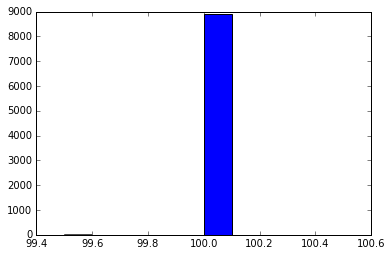

(100.0, 0.0, 100.0)


In [59]:
import matplotlib.pyplot as plt
%matplotlib inline
this_set = _wbc

plt.figure()
plt.hist(this_set)
plt.show()

print(np.mean(this_set), np.std(this_set), np.median(this_set))

# test generator() with data augmentation

In [10]:

def crop_to_images(image, bboxes, labels, size):

    def crop_bboxes(bboxes, labels, boundaries):
        # print('boundaries', boundaries)
        boxes, objclass = [], []
        for (ymin, xmin, ymax, xmax), l in zip(bboxes, labels):
            x, y = xmin + int((xmax - xmin) / 2.), ymin + int((ymax - ymin) / 2.)
            # 5 pixels tolerance
            if boundaries[0]-10 < x <= boundaries[1]+10 and boundaries[2]-10 < y <= boundaries[3]+10:
                boxes.append((ymin - boundaries[2],
                              xmin - boundaries[0],
                              ymax - boundaries[2],
                              xmax - boundaries[0]))
                objclass.append(l)
        return np.array(boxes), np.array(objclass)
    
#     h, w = image.shape
#     cw = int(np.ceil(1./(size/float(w))))
#     ch = int(np.ceil(1./(size/float(h))))
    
    num_samples_width = int(np.ceil(image.shape[1] / float(size)))
    num_samples_height = int(np.ceil(image.shape[0] / float(size)))
    
    # meshgrid of center coordinates
    half = int(size/2.)
    x, y = np.meshgrid(np.arange(half, num_samples_width*size, size), 
                       np.arange(half, num_samples_height*size, size))
    x, y = x.ravel(), y.ravel()

    # correct for center coordinates that are out of range
    is_outside = x + half > image.shape[1]
    if any(is_outside):
        idx = np.where(is_outside)[0]
        x[idx] = image.shape[1] - half

    is_outside = y + half > image.shape[0]
    if any(is_outside):
        idx = np.where(is_outside)[0]
        y[idx] = image.shape[0] - half

    # crop and gather only boxes that fall inside the crop
    new_images, new_bboxes = [], []
    for xi, yi in zip(x, y):
        xmin, xmax = xi-half, xi+half
        ymin, ymax = yi-half, yi+half

        new_images.append(image[ymin:ymax, xmin:xmax, :])
        new_bboxes.append(crop_bboxes(bboxes, labels, (xmin, xmax, ymin, ymax)))
            
    return new_images, new_bboxes


from scipy.ndimage import zoom
def clipped_zoom_in(img, bb, zoom_factor, **kwargs):

    h, w = img.shape[:2]
    if bb.any():
        ymin, xmin, ymax, xmax = bb.T
        bw, bh = xmax - xmin, ymax - ymin
        x, y = xmin + np.int32(bw / 2.), ymin + np.int32(bh / 2.)

    # width and height of the zoomed image
    zh = int(np.round(zoom_factor * h))
    zw = int(np.round(zoom_factor * w))

    # for multichannel images we don't want to apply the zoom factor to the RGB
    # dimension, so instead we create a tuple of zoom factors, one per array
    # dimension, with 1's for any trailing dimensions after the width and height.
    zoom_tuple = (zoom_factor,) * 2 + (1,) * (img.ndim - 2)

    # bounding box of the clip region within the input array
    top = (zh - h) // 2
    left = (zw - w) // 2
    out = zoom(img[top:top+zh, left:left+zw], zoom_tuple, **kwargs)

    # clip and zoom coordinates too
    if bb.any():
        x, y = (x - left) * zoom_factor, (y - top) * zoom_factor
        bw, bh = bw * zoom_factor, bh * zoom_factor

    # `out` might still be slightly larger than `img` due to rounding, so
    # trim off any extra pixels at the edges
    trim_top = ((out.shape[0] - h) // 2)
    trim_left = ((out.shape[1] - w) // 2)
    out = out[trim_top:trim_top+h, trim_left:trim_left+w]

    # clip coordinates once more
    if bb.any():
        x, y = x - trim_left, y - trim_top

        # delete x,y coordinates that fall outside 'out' (5 pixels tolerance)
        bb_out = []
        for i, (xi, yi) in enumerate(zip(x, y)):
            if -5 < xi < w + 5 and -5 < yi < h + 5:
                xmin, xmax = int(xi - (bw[i] / 2.)), int(xi + (bw[i] / 2.))
                ymin, ymax = int(yi - (bh[i] / 2.)), int(yi + (bh[i] / 2.))
                bb_out.append([ymin, xmin, ymax, xmax])

        return out, np.array(bb_out)
    else:
        return out, np.zeros((0, 4))

    
def to_relative_coordinates(boxes, shape):
    '''
        Absolute pixel values into relative ones.
        Also, reordering of coordinates to match tf implementation.

    :param boxes: numpy array. coordinates of bounding boxes (N x 4)
    :param shape: tuple. image shape.

    :return: (ymin, xmin, ymax, xmax)
    '''

    ymin, xmin, ymax, xmax = boxes.T

    xmin = xmin / float(shape[1])
    xmax = xmax / float(shape[1])
    ymin = ymin / float(shape[0])
    ymax = ymax / float(shape[0])

    return np.concatenate([ymin[:, None], xmin[:, None], ymax[:, None], xmax[:, None]], axis=-1)


def rotate_point(point, angle, img):
    theta = np.pi / 180 * angle * -1
    img_center = np.array([img.shape[1] / 2 - 1, img.shape[0] / 2 - 1]).reshape((1, 2))
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                [np.sin(theta), np.cos(theta)]])
    rect_point = np.array([point[0] - img_center[0, 0], img_center[0, 1] - point[1]], dtype=float).reshape((1, 2))
    rect_point2 = np.matmul(rect_point, rotation_matrix)
    rect_point3 = np.array([rect_point2[0, 0] + img_center[0, 0], img_center[0, 1] - rect_point2[0, 1]]).reshape((1, 2))

    return rect_point3[0, 0], rect_point3[0, 1]


def rotate_rectangle(points, angle, img):
    ymin, xmin, ymax, xmax = points
    
    point1 = rotate_point((xmin, ymin), angle, img)
    point2 = rotate_point((xmax, ymin), angle, img)
    point3 = rotate_point((xmin, ymax), angle, img)
    point4 = rotate_point((xmax, ymax), angle, img)

    xmin_t = min(point1[0], point2[0], point3[0], point4[0])
    xmax_t = max(point1[0], point2[0], point3[0], point4[0])
    ymin_t = min(point1[1], point2[1], point3[1], point4[1])
    ymax_t = max(point1[1], point2[1], point3[1], point4[1])

    return ymin_t, xmin_t, ymax_t, xmax_t

def flip_rectangle(points, axis, img):
    ymin, xmin, ymax, xmax = points
    h, w, _ = img.shape
    
    if axis == 0:
        ymin = h - ymin
        ymax = h - ymax
    elif axis == 1:
        xmin = w - xmin
        xmax = w - xmax
    else:
        raise ValueError('axis can either be "0" (vertical) or "1" (horizontal)', str(axis))

    if xmin > xmax:
        xt = xmax
        xmax = xmin
        xmin = xt
    if ymin > ymax:
        xt = ymax
        ymax = ymin
        ymin = xt

    return ymin, xmin, ymax, xmax

def rotate(img, bb, angle):
    rot_img = np.asarray(scp.ndimage.rotate(img, angle), dtype=np.float32)
    rot_bb = []
    for i in bb:
        rot_bb.append(rotate_rectangle(i, angle, img))

    return rot_img, np.array(rot_bb)



def flip(img, bb, axis):
    flip_img = np.asarray(np.flip(img, axis=axis), dtype=np.float32)
    flip_bb = []
    for i in bb:
        flip_bb.append(flip_rectangle(i, axis, img))
        
    return flip_img, np.array(flip_bb)


In [161]:
def generator(gt, keys, bs, dset='train', size=512, random=True):

    while True:
        if random:
            np.random.shuffle(keys)
        targets, inputs = [], []

        for k in keys:
            if os.path.join(preprocess_dir, dset, k):
                
                # source
                img = misc.imread(os.path.join(preprocess_dir, dset, k)) / 255.
                bb = gt[k][0]
                objclass = gt[k][1]
                
#                 data augmentation
#                 if np.random.rand() > 0.0:
#                     img, bb = clipped_zoom_in(img, bb, zoom_factor=1.3)

                if np.random.rand() > 0.0:
                    rot_angle = np.random.choice([90, 180, 270])
                    img, bb = rotate(img, bb, rot_angle)

#                 if np.random.rand() > 0.0:
#                     flip_axis = np.random.choice([0, 1])
#                     img, bb = flip(img, bb, flip_axis)

                inputs.append(img)

                # sort coordinates on tf implementation format and to relative coordinates
                if bb.any():
                    bb = to_relative_coordinates(bb, (size, size, 3))
                    objclass = np.int32(np.argmax(objclass, axis=1) + 1)
                else:
                    bb = np.zeros((0, 4), dtype='float32')
                    objclass = np.zeros((0,), dtype='int32')
                
                targets.append([bb, objclass])
                
                if len(targets) == bs:
                    yield inputs, targets
#                     yield np.array(inputs, dtype=np.float32), np.array(targets, dtype=np.float32)
                    inputs, targets = [], []

In [162]:
from numpy import random
def plt_bboxes_original(img, classes, bboxes, saveto, figsize=(10,10), linewidth=1.5):
    """Visualize bounding boxes. Largely inspired by SSD-MXNET!
    """
    fig = plt.figure(figsize=figsize)
    plt.imshow(img)
    height = img.shape[0]
    width = img.shape[1]
    colors = dict()
    # handles = []
    for i in range(classes.shape[0]):
        cls_id = int(classes[i])
        colors[cls_id] = (random.random(), random.random(), random.random())
        if bboxes[i].any():
            for j in range(len(bboxes[i])):
                ymin = int(bboxes[i][j, 0] * height)
                xmin = int(bboxes[i][j, 1] * width)
                ymax = int(bboxes[i][j, 2] * height)
                xmax = int(bboxes[i][j, 3] * width)
#                 ymin = int(bboxes[i][j, 0])
#                 xmin = int(bboxes[i][j, 1])
#                 ymax = int(bboxes[i][j, 2])
#                 xmax = int(bboxes[i][j, 3])
#                 print(xmin, xmax, ymin, ymax)
                rect = plt.Rectangle((xmin, ymin), xmax - xmin,
                                     ymax - ymin, fill=False,
                                     label=None,
                                     edgecolor=colors[cls_id],
                                     linewidth=linewidth)

                plt.gca().add_patch(rect)
            # h, = plt.plot(0., 0., label=str(i), color=colors[cls_id])
            # handles.append(h)
            # plt.legend(handles=handles, labels=[str(i) for i in classes])
    plt.show()

# Test crop_images for different sizes (WORKING)

In [83]:
gt = pickle.load(open('../../../data/datasetQuinn/curated/gt_train_fal_wbc_prep.pickle', 'rb'))

k = list(gt.keys())
z = 153

In [79]:
src_image = misc.imread(os.path.join(preprocess_dir, 'train', k[z])) / 255.
src_boxes = gt[k[z]][0]
src_labels = gt[k[z]][1]
images, annotations = crop_to_images(src_image, src_boxes, src_labels, size=256)

In [80]:
src_boxes

array([[ 293,   82,  393,  182],
       [ 406,  958,  456, 1008],
       [ 242,  979,  292, 1029],
       [ 202,  792,  252,  842],
       [ 106,  583,  156,  633],
       [ 114,  522,  164,  572],
       [  75,  215,  125,  265],
       [ 563,  393,  613,  443],
       [ 644,  295,  694,  345],
       [ 629,  290,  679,  340],
       [ 722,  125,  772,  175],
       [ 718,   98,  768,  148],
       [ 420,  223,  470,  273],
       [ 353,  101,  403,  151]])

In [81]:
for i, j in zip(images, annotations):
    print(j)
    plt_bboxes_original(i, np.array([0]), [j[0]], None, figsize=(10,10), linewidth=1.5)


(array([[ 75, 215, 125, 265]]), array([[1, 0]]))
(array([], dtype=float64), array([], dtype=float64))
(array([[106,  71, 156, 121],
       [114,  10, 164,  60]]), array([[1, 0],
       [1, 0]]))
(array([[202,  24, 252,  74]]), array([[1, 0]]))
(array([[ 37,  82, 137, 182],
       [164, 223, 214, 273],
       [ 97, 101, 147, 151]]), array([[0, 1],
       [1, 0],
       [1, 0]]))
(array([[164, -33, 214,  17]]), array([[1, 0]]))
(array([], dtype=float64), array([], dtype=float64))
(array([[150, 190, 200, 240],
       [-14, 211,  36, 261]]), array([[1, 0],
       [1, 0]]))
(array([[210, 125, 260, 175],
       [206,  98, 256, 148]]), array([[1, 0],
       [1, 0]]))
(array([[ 51, 137, 101, 187],
       [132,  39, 182,  89],
       [117,  34, 167,  84]]), array([[1, 0],
       [1, 0],
       [1, 0]]))
(array([], dtype=float64), array([], dtype=float64))
(array([], dtype=float64), array([], dtype=float64))


# Verify gt dictionaries (WORKING)

In [176]:
import scipy as scp
import numpy as np
from scipy import misc
import matplotlib.pyplot as plt

In [177]:
gt = pickle.load(open('../../../data/datasetQuinn/curated/gt_train0_fal_wbc_prep.pickle', 'rb'))

In [178]:
k = list(gt.keys())
gen = generator(gt, k, 10, dset='train0', size=256, random=True)


In [179]:
i, o = next(gen)

In [180]:
for ii, oo in zip(i, o):
    plt_bboxes_original(ii, np.array([0]), [oo[0]], None, figsize=(10,10), linewidth=1.5)